# Task: Audio Classification
Classify if the artist is a singer or a rapper by their Music


# Step 0: Import Dependencies

In [1]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
print(f'tensorflow version: {tf.__version__}')

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import BinaryCrossentropy
from sklearn.metrics import classification_report

from sklearn import metrics
from sklearn.model_selection import train_test_split


import librosa
import librosa.display
import soundfile as sf

import seaborn as sns
import matplotlib.pyplot as plt
import IPython.display as ipd


from itertools import cycle


sns.set_theme(style = 'white', palette=None)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()['color']
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()['color'])



tensorflow version: 2.6.4


# Step 1: Import Audio Tracks (For EDA purpose only)

In [2]:
s = []
for root, dirs, files in os.walk("/kaggle/input/singer-vs-rapper/Artists/Singer", topdown=False):
    for name in files:
        if name != '.DS_Store':
            abs_path = os.path.join(root,name)
            s.append(abs_path)
        
r = []
for root, dirs, files in os.walk("/kaggle/input/singer-vs-rapper/Artists/Rapper", topdown=False):
     for name in files:
        if name != '.DS_Store':
            abs_path = os.path.join(root,name)
            r.append(abs_path)

s

['/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Afraid-To-Say-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-All-Around-Me-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Ft-Burna-Boy-Loved-By-You-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Thats-What-Love-Is-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Freedom-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin_Bieber_Stuck_with_U_(thinkNews.com.ng).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Somebody-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Off-My-Face-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Running-Over-feat-Lil-Dicky-(TrendyBeatz.com).mp3',
 '/kaggle/input/singer-vs-rapper/Artists/Singer/Justin-Bieber-Habitual-(TrendyBeat

## Singer

/opt/conda/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)


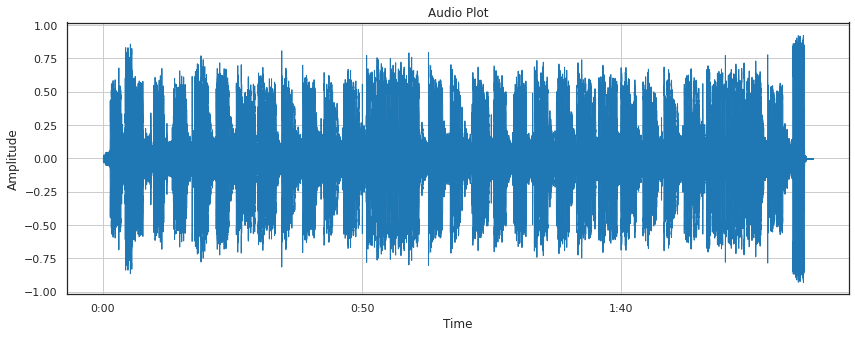

In [3]:
x , sr = librosa.load(s[1])
plt.figure(figsize=(14, 5))
plt.grid()
librosa.display.waveshow(x, sr=sr, color=color_pal[0])
plt.title("Audio Plot")
a = plt.ylabel("Amplitude")

display(ipd.Audio(x, rate=sr))

# Rapper

/opt/conda/lib/python3.7/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)


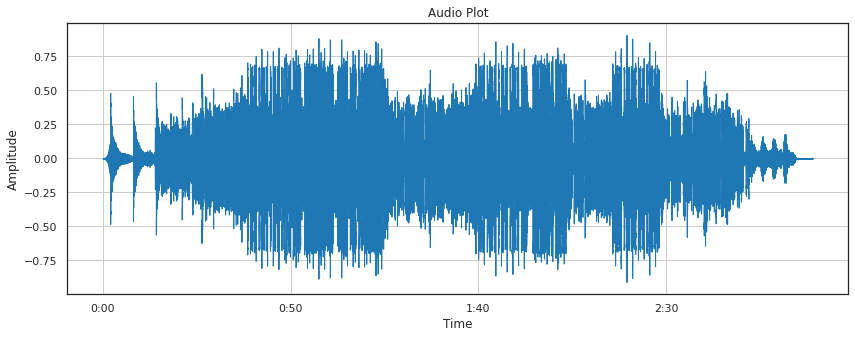

In [4]:
x , sr = librosa.load(r[1])
plt.figure(figsize=(14, 5))
plt.grid()
librosa.display.waveshow(x, sr=sr, color=color_pal[0])
plt.title("Audio Plot")
a = plt.ylabel("Amplitude")
display(ipd.Audio(x, rate=sr))

# Step 2: Spleeter to Extract Vocals (Using Terminal)
- Spleeter is a library that extracts vocals from audio tracks - https://github.com/deezer/spleeter

- I did the extraction in my local machine as spleeter requires a custom env and I have uploaded this dataset as - ../input/singer-vs-rapper/Vocals. Check data on the right

- The script has been provided below


In [5]:
### Extracting Vocals from Songs - Using Spleeter

### Function to handle multiple audio files from a list (path) and store the vocals of those files in a o/p dir
# def extract_vocals(input_list, output_dir):
#     for i in input_list:
#         command = 'spleeter separate ' + i + ' -o ' + output_dir
#         os.system(command)

# output_dir = '/singer-vs-rapper/Vocals/Singer'
# os.makedirs(output_dir, exist_ok=True)
    
# extract_vocals(s, output_dir)


# output_dir = 'singer-vs-rapper/Vocals/Rapper
# os.makedirs(output_dir, exist_ok=True)
    
# extract_vocals(r, output_dir)

# Step 3: Importing Vocals (For EDA purposes)

In [6]:
vocals = []
target = []
for root, dirs, files in os.walk("/kaggle/input/singer-vs-rapper/Vocals/Singer", topdown=False):
     for name in files:
        if name != '.DS_Store' and name != 'accompaniment.wav':
            abs_path = os.path.join(root,name)
            vocals.append(abs_path)
            target.append('Singer')
            


for root, dirs, files in os.walk("/kaggle/input/singer-vs-rapper/Vocals/Rapper", topdown=False):
     for name in files:
        if name != '.DS_Store' and name != 'accompaniment.wav':
            abs_path = os.path.join(root,name)
            vocals.append(abs_path)
            target.append('Rapper')

df = pd.DataFrame({'Vocals': vocals, 'Target': target})
df

,Vocals,Target
0,/kaggle/input/singer-vs-rapper/Vocals/Singer/2...,Singer
1,/kaggle/input/singer-vs-rapper/Vocals/Singer/5...,Singer
2,/kaggle/input/singer-vs-rapper/Vocals/Singer/3...,Singer
3,/kaggle/input/singer-vs-rapper/Vocals/Singer/1...,Singer
4,/kaggle/input/singer-vs-rapper/Vocals/Singer/4...,Singer
5,/kaggle/input/singer-vs-rapper/Vocals/Rapper/2...,Rapper
6,/kaggle/input/singer-vs-rapper/Vocals/Rapper/5...,Rapper
7,/kaggle/input/singer-vs-rapper/Vocals/Rapper/3...,Rapper
8,/kaggle/input/singer-vs-rapper/Vocals/Rapper/1...,Rapper
9,/kaggle/input/singer-vs-rapper/Vocals/Rapper/4...,Rapper


# Step 3: Plotting Vocals

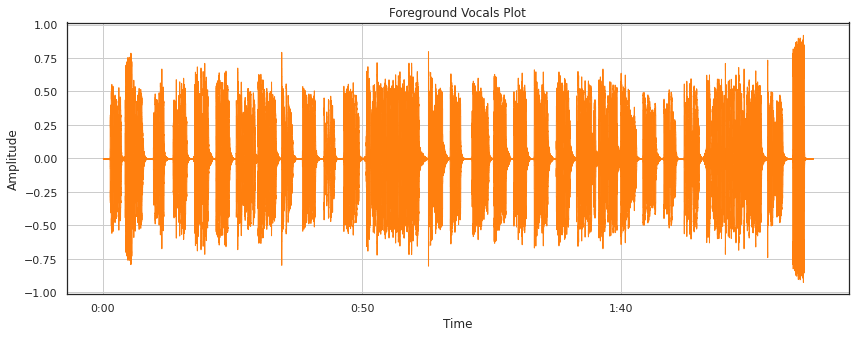

In [7]:
#Plot the signal:
plt.figure(figsize=(14, 5))
plt.grid()
x , sr = librosa.load(df.Vocals[0])
librosa.display.waveshow(x, sr=sr, color=color_pal[1])
plt.title("Foreground Vocals Plot")
a = plt.ylabel("Amplitude")


In [8]:
ipd.Audio(x, rate=sr)

# Step 4: Removing Silent Sections from the Audio

In [9]:
nonMuteSections = librosa.effects.split(x, top_db=20)
nonMuteSections

array([[  28672,   77312],
       [  92160,  170496],
       [ 212480,  259584],
       [ 296960,  318976],
       [ 319488,  356864],
       [ 387584,  449024],
       [ 478720,  510976],
       [ 511488,  519680],
       [ 520704,  538112],
       [ 564736,  590336],
       [ 590848,  598016],
       [ 599040,  629760],
       [ 631296,  635392],
       [ 636416,  647168],
       [ 656896,  665088],
       [ 665600,  736768],
       [ 757760,  781824],
       [ 784384,  805888],
       [ 846848,  903168],
       [ 937984,  941568],
       [ 944128,  950784],
       [ 954880,  962048],
       [ 965120,  983552],
       [1021952, 1069568],
       [1072128, 1088512],
       [1117696, 1138176],
       [1140224, 1161216],
       [1162752, 1184768],
       [1185280, 1196032],
       [1197056, 1207296],
       [1208320, 1236480],
       [1237504, 1240576],
       [1242112, 1297408],
       [1298432, 1344512],
       [1381888, 1444352],
       [1474560, 1521152],
       [1566720, 1640448],
 

In [10]:
wav = np.concatenate([x[start:end] for start, end in nonMuteSections])

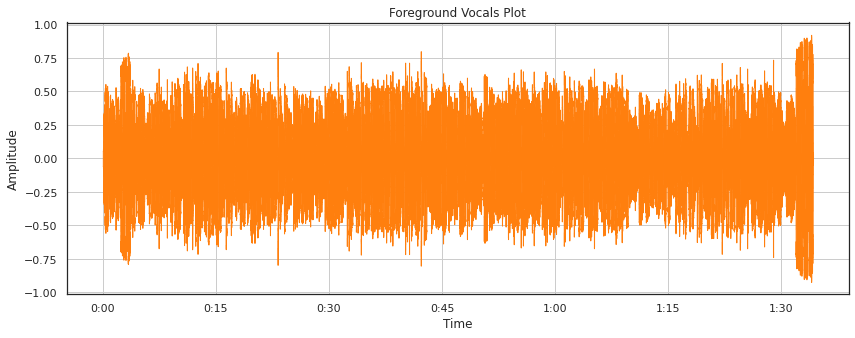

In [11]:
plt.figure(figsize=(14, 5))
plt.grid()
librosa.display.waveshow(wav, sr=sr, color=color_pal[1])
plt.title("Foreground Vocals Plot")
a = plt.ylabel("Amplitude")

ipd.Audio(wav, rate=sr)

# Extracting Audio Samples (Around 6 secs)

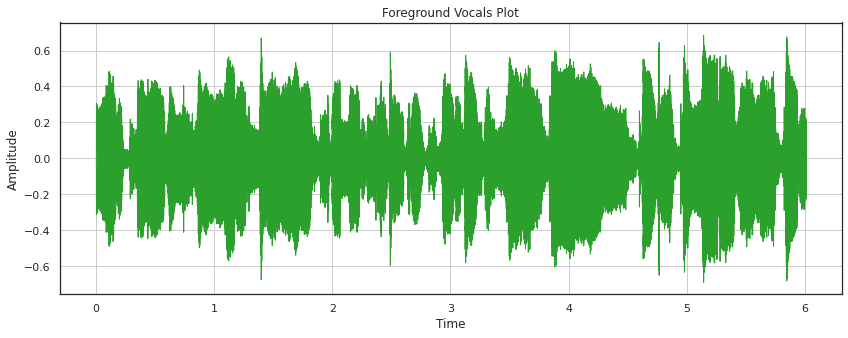

In [12]:
a = 132500
interval_1 = wav[a:a*2]
plt.figure(figsize=(14, 5))
plt.grid()
librosa.display.waveshow(interval_1, sr=sr, color=color_pal[2])
plt.title("Foreground Vocals Plot")
a = plt.ylabel("Amplitude")
ipd.Audio(interval_1, rate=sr)

### A function to - Remove Silence & Get 5 sec Samples (5 samples per track)
- A script of how I extracted samples. This has been uploaded to kaggle - ../input/singer-vs-rapper/Samples 
- Check data on the right.

In [13]:
### putting it all in a script and saving these files

# dir_path = '/Users/siddharthmandgi/Desktop/Samples'
# os.makedirs(dir_path, exist_ok=True)

# interval_length = 132500

# def foreground_process(input_list, final_directory, interval_length=132500, number_of_intervals=6):   
#     count = 1
#     for i in input_list:
#         x , sr = librosa.load(i)
#         nonMuteSections = librosa.effects.split(x, top_db=20)
#         wav = np.concatenate([x[start:end] for start, end in nonMuteSections])
#         for i in range(number_of_intervals):
#             interval = wav[(i+1)*interval_length:(i+2)*interval_length]
#             sf.write(final_directory+'/'+str(count)+'.wav', interval, sr, 'PCM_24')
#             count+=1
            
        
# final_directory = '/Users/siddharthmandgi/Desktop/Samples/Singer'
# os.makedirs(final_directory, exist_ok=True)
# foreground_process(df.Vocals[df.Target=='Singer'], final_directory)


# final_directory = '/Users/siddharthmandgi/Desktop/Samples/Rapper'
# os.makedirs(final_directory, exist_ok=True)
# foreground_process(df.Vocals[df.Target=='Rapper'], final_directory)         

# Samples Data - Most important for Classification
5 sec vocal samples with quiet sections removed

In [14]:
vocals = []
target = []
for root, dirs, files in os.walk("/kaggle/input/singer-vs-rapper/Samples/Singer", topdown=False):
     for name in files:
        if name != '.DS_Store' and name != 'accompaniment.wav':
            abs_path = os.path.join(root,name)
            vocals.append(abs_path)
            target.append('Singer')
            


for root, dirs, files in os.walk("/kaggle/input/singer-vs-rapper/Samples/Rapper", topdown=False):
     for name in files:
        if name != '.DS_Store' and name != 'accompaniment.wav':
            abs_path = os.path.join(root,name)
            vocals.append(abs_path)
            target.append('Rapper')

df_samples = pd.DataFrame({'Vocals': vocals, 'Target': target})
df_samples

,Vocals,Target
0,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer
1,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer
2,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer
3,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer
4,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer
...,...,...
295,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper
296,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper
297,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper
298,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper


# Checking Balance in the dataset

/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


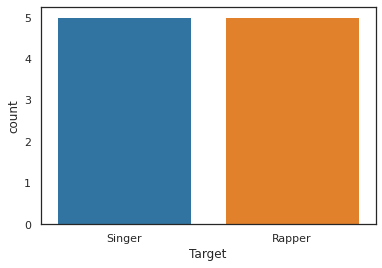

In [15]:
sns.countplot(df["Target"],orient="V")
plot = plt.show()

 The dataset is pretty balanced

# Extract Features - Mel Frequency Cepestral Coefficents (MFCC)

- MFCC summarizes the frequency distribution across window size, so it possible to analyze both the frequency and time characteristics of the sound. 
- The audio representations will allow us to identify features for classification.

In [16]:
mfcc = librosa.feature.mfcc(y=wav, sr=sr)
mfcc

array([[-2.5830972e+02, -1.7042349e+02, -1.4271857e+02, ...,
        -2.6451965e+02, -2.9512088e+02, -3.5358765e+02],
       [ 8.0116930e+00,  2.2623589e+01,  1.6773312e+01, ...,
         1.4118906e+02,  1.3336761e+02,  1.1028937e+02],
       [ 6.2640557e+00,  1.6244238e+01,  2.3402966e+01, ...,
         3.5531853e+01,  2.0316811e+01,  2.7051411e+01],
       ...,
       [ 2.3138087e+00, -7.2149646e-01, -1.9948224e+00, ...,
        -7.8878164e-02,  4.0303726e+00,  6.9986134e+00],
       [-1.4405039e+01, -1.6197561e+01, -1.4049625e+01, ...,
        -1.0701812e+01, -2.3420291e+00,  1.6578444e+00],
       [-5.3580027e+00, -9.4146852e+00, -1.4558625e+01, ...,
        -7.5699053e+00, -6.1231232e+00,  1.2847900e-02]], dtype=float32)

In [17]:
print(mfcc.shape)

(20, 4059)


In [18]:
### Extract features and scale for 1 audio file
def feature_extractor(file):
    audio, sr = librosa.load(file)
    mfccs_features = librosa.feature.mfcc(y=audio, sr=sr)
    mfccs_scaled_features = np.mean(mfccs_features.T, axis=0)
    
    return mfccs_scaled_features

In [19]:
### Batch Extractor (input list of all absolute paths of audio files)
def batch_extractor(input_list):
    extracted_features = []
    for i in input_list:
        extracted_features.append(feature_extractor(i))
    
    return extracted_features

extracted_features = batch_extractor(df_samples.Vocals)

In [20]:
df_samples['features'] = extracted_features
df_samples

,Vocals,Target,features
0,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-184.60307, 11.258544, -38.614788, -36.743767..."
1,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-166.29407, 45.380436, -60.559135, -19.87944,..."
2,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-252.07063, 66.548256, -20.34138, -13.806844,..."
3,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-180.05801, -9.887467, -27.874762, -11.124967..."
4,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-124.61381, 28.925272, -36.73302, -25.841684,..."
...,...,...,...
295,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-259.2243, 53.003742, -53.925343, 4.243302, -..."
296,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-184.86615, -2.6553855, 1.216022, 31.576874, ..."
297,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-221.3099, 58.51981, -35.82584, 18.483353, 7...."
298,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-125.24697, 73.50261, -57.886898, -27.472628,..."


In [21]:
#### Shuffling the dataset
df_samples = df_samples.sample(frac=1).reset_index(drop=True)
df_samples

,Vocals,Target,features
0,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-205.21275, 27.679543, -39.03045, -30.410465,..."
1,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-186.31493, 37.339546, -38.817, -22.566248, -..."
2,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-147.72705, 34.34113, -46.70725, 25.986116, -..."
3,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-145.36453, 2.726949, -29.074389, 14.551531, ..."
4,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-105.43548, 51.681557, -34.710476, -16.000647..."
...,...,...,...
295,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-191.54631, 61.574226, 30.534319, 17.682892, ..."
296,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-181.33395, 31.383461, -19.67115, -19.165619,..."
297,/kaggle/input/singer-vs-rapper/Samples/Singer/...,Singer,"[-220.7441, -23.94441, -33.22289, -28.968027, ..."
298,/kaggle/input/singer-vs-rapper/Samples/Rapper/...,Rapper,"[-188.0944, 85.462524, -31.353014, -6.271654, ..."


In [22]:
df_samples.replace({'Singer':1,'Rapper':0}, inplace = True)
X = np.array(df_samples['features'].tolist())
y = np.array(df_samples['Target'].tolist())
y

/opt/conda/lib/python3.7/site-packages/pandas/core/array_algos/replace.py:84: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  op = lambda x: operator.eq(x, b)


array([1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0,
       0, 1, 1, 0, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1,
       1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0,
       0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1,
       1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0,
       1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0,
       1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0,
       0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1])

In [23]:
print(X.shape)
print(y.shape)

(300, 20)
(300,)


In [24]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.20)
print(X_train.shape)
print(y_train.shape)

(240, 20)
(240,)


# Model Building

In [25]:
model = Sequential()

#### First layer stack
model.add(Dense(100, input_shape=(20,)))
model.add(Activation('relu'))
model.add(Dropout(0.5))


#### Second layer stack
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))


#### Third layer stack
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))


### Final Layer
model.add(Dense(1))
model.add(Activation("sigmoid"))

model.summary()

2022-07-11 04:47:18.982189: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 100)               2100      
_________________________________________________________________
activation (Activation)      (None, 100)               0         
_________________________________________________________________
dropout (Dropout)            (None, 100)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 200)               20200     
_________________________________________________________________
activation_1 (Activation)    (None, 200)               0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 200)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 200)               4

2022-07-11 04:47:19.076341: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-11 04:47:19.077136: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-07-11 04:47:19.078577: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-07-11 04:47:19.078876: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA 

In [26]:
### Save the best model
saved_callbacks = ModelCheckpoint('./saved_models/bestmodel',
                                     save_weights_only=False, 
                                     monitor='loss', 
                                     save_best_only=True)
    
### Complie and Fit Model 
model.compile(optimizer = Adam(),
             loss = BinaryCrossentropy(),
              metrics = ['accuracy',])  

history = model.fit(X_train, y_train, epochs=100, batch_size=32,
                   callbacks=[saved_callbacks]
    )

2022-07-11 04:47:22.710409: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:185] None of the MLIR Optimization Passes are enabled (registered 2)


Epoch 1/100
8/8 [==============================] - 1s 3ms/step - loss: 13.9898 - accuracy: 0.4458


2022-07-11 04:47:24.614580: W tensorflow/python/util/util.cc:348] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.


Epoch 2/100
8/8 [==============================] - 0s 3ms/step - loss: 9.0569 - accuracy: 0.5000
Epoch 3/100
8/8 [==============================] - 0s 3ms/step - loss: 6.1285 - accuracy: 0.5500
Epoch 4/100
8/8 [==============================] - 0s 3ms/step - loss: 5.7297 - accuracy: 0.5583
Epoch 5/100
8/8 [==============================] - 0s 3ms/step - loss: 4.4006 - accuracy: 0.5500
Epoch 6/100
8/8 [==============================] - 0s 3ms/step - loss: 4.0872 - accuracy: 0.6208
Epoch 7/100
8/8 [==============================] - 0s 3ms/step - loss: 3.6599 - accuracy: 0.5750
Epoch 8/100
8/8 [==============================] - 0s 3ms/step - loss: 3.4426 - accuracy: 0.6458
Epoch 9/100
8/8 [==============================] - 0s 3ms/step - loss: 2.5283 - accuracy: 0.6833
Epoch 10/100
8/8 [==============================] - 0s 3ms/step - loss: 2.3584 - accuracy: 0.6750
Epoch 11/100
8/8 [==============================] - 0s 3ms/step - loss: 1.8879 - accuracy: 0.6792
Epoch 12/100
8/8 [==========

# Evaluation

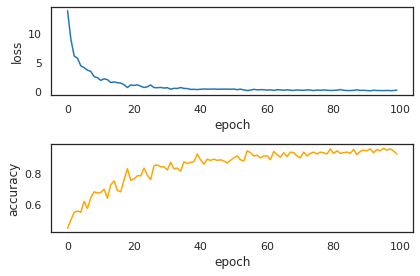

In [27]:
plt.subplot(2 ,1, 1)
a = plt.plot(history.history['loss'])
plt.ylabel('loss')
plt.xlabel('epoch')


plt.subplot(2, 1 ,2)
b = plt.plot(history.history['accuracy'],color="orange")
plt.ylabel('accuracy')
plt.xlabel('epoch')

plt.tight_layout()
plt.show()

In [28]:
y_preds = model.predict(X_test)
y_preds = (y_preds>0.5).flatten()
y_preds = y_preds.astype('int')
y_preds

array([0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0])

In [29]:
print(classification_report(y_preds, y_test))

              precision    recall  f1-score   support

           0       0.94      0.97      0.95        30
           1       0.97      0.93      0.95        30

    accuracy                           0.95        60
   macro avg       0.95      0.95      0.95        60
weighted avg       0.95      0.95      0.95        60

